In [24]:
import thinkdsp
import matplotlib.pyplot as plt
import IPython.display as idsp
train_wave = thinkdsp.read_wave("../data/train.wav")


Here is the original audio I am using. It's an Amtrak train arriving at BWI. This sounds worse than the actual .wav that I downloaded. I'm not sure why. I think it may have to do with the way that it's read/written by thinkdsp

In [25]:
train_wave.make_audio()

Here is a half second sample to show some of the frequencies and waveforms involved.

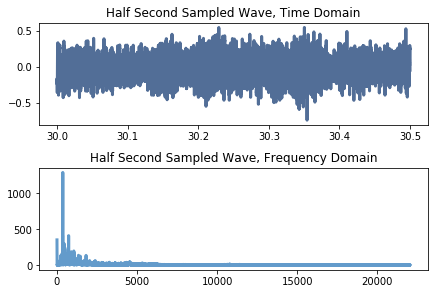

In [20]:
braking_time_domain = train_wave.segment(30,.5)
braking_frequency_domain = braking_time_domain.make_spectrum()
ax1 = plt.subplot(2,1,1)
ax1.set_title('Half Second Sampled Wave, Time Domain')
braking_time_domain.plot()
ax2 = plt.subplot(2,1,2)
ax2.set_title('Half Second Sampled Wave, Frequency Domain')
braking_frequency_domain.plot()
plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)


Next, I will apply some filters. I'm going to apply these to the entire recording, because it's hard to listen to a half second recording. I am first going to apply a low pass filter. Notice that the sound is muffled after I attenuated some of the higher frequencies.


In [21]:
low_pass_train_spectrum = train_wave.make_spectrum()
low_pass_train_spectrum.low_pass(cutoff=2500, factor=.01)
low_pass_train_wave = low_pass_train_spectrum.make_wave()
low_pass_train_wave.make_audio()


Now I will apply a high pass filter. This one really leaves the "screechiness" of the braking wheels. It's pretty stressfull to listen to.

In [22]:
high_pass_train_spectrum = train_wave.make_spectrum()
high_pass_train_spectrum.high_pass(cutoff=5000, factor=.01)
high_pass_train_wave = high_pass_train_spectrum.make_wave()
high_pass_train_wave.make_audio()

Now I'll apply a band stop. I'm surprised that I did not filter out the speaking.

In [23]:
mid_pass_train_spectrum = train_wave.make_spectrum()
mid_pass_train_spectrum.band_stop(low_cutoff=2500, high_cutoff=5000, factor=.01)
mid_pass_train_wave = mid_pass_train_spectrum.make_wave()
mid_pass_train_wave.make_audio()
